<a href="https://colab.research.google.com/github/Kewal1903/YOLO_from_scratch/blob/main/YOLOv7.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="8NWJgXFUuCkE6hxPRXgZ")
project = rf.workspace("roboflow-100").project("chess-pieces-mjzgj")
version = project.version(2)
dataset = version.download("darknet")

loading Roboflow workspace...
loading Roboflow project...


In [ ]:
!git clone https://github.com/WongKinYiu/yolov7
%cd yolov7

fatal: destination path 'yolov7' already exists and is not an empty directory.
/content/yolov7


In [ ]:
!pip install -r requirements.txt

In [ ]:
%cd /content/yolov7/data
with open('custom_dataset.yaml', 'w') as f:
    f.write('''
train: /content/chess-pieces-2/train
val: /content/chess-pieces-2/valid

# number of classes
nc: 13

# class names
names: ['class1', 'class2', 'class3', 'class4','class5','class6','class7','class8','class9','class10','class11','class12','class13']
''')

/content/yolov7/data


In [ ]:
%cd /content/yolov7
!python train.py --img 640 --batch 16 --epochs 50 --data data/custom_dataset.yaml --cfg cfg/training/yolov7.yaml --weights yolov7.pt --name yolov7_custom


/content/yolov7
2024-07-26 01:29:08.360570: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-07-26 01:29:08.360626: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-07-26 01:29:08.362696: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-07-26 01:29:08.375194: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-07-26 01:29:09.866279: W

In [ ]:
!python test.py --weights runs/train/yolov7_custom/weights/best.pt --data data/custom_dataset.yaml --img 640

Namespace(weights=['runs/train/yolov7_custom/weights/best.pt'], data='data/custom_dataset.yaml', batch_size=32, img_size=640, conf_thres=0.001, iou_thres=0.65, task='val', device='', single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project='runs/test', name='exp', exist_ok=False, no_trace=False, v5_metric=False)
YOLOR 🚀 v0.1-128-ga207844 torch 2.3.1+cu121 CUDA:0 (Tesla T4, 15102.0625MB)

Fusing layers... 
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
IDetect.fuse
/usr/local/lib/python3.10/dist-packages/torch/functional.py:512: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3587.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
Model Summary: 314 layers, 36546500 parameters, 6194944 gradients, 103.4 GFLOPS
 Convert model to Traced-model... 
 trac

In [ ]:
!python detect.py --weights runs/train/yolov7_custom/weights/best.pt --img 640 --conf 0.25 --source /content/chess-pieces-2/valid

Namespace(weights=['runs/train/yolov7_custom/weights/best.pt'], source='/content/chess-pieces-2/valid', img_size=640, conf_thres=0.25, iou_thres=0.45, device='', view_img=False, save_txt=False, save_conf=False, nosave=False, classes=None, agnostic_nms=False, augment=False, update=False, project='runs/detect', name='exp', exist_ok=False, no_trace=False)
YOLOR 🚀 v0.1-128-ga207844 torch 2.3.1+cu121 CUDA:0 (Tesla T4, 15102.0625MB)

Fusing layers... 
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
IDetect.fuse
/usr/local/lib/python3.10/dist-packages/torch/functional.py:512: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3587.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
Model Summary: 314 layers, 36546500 parameters, 6194944 gradients, 103.4 GFLOPS
 Convert model to Traced-model... 
 traced_script_module saved! 
 m

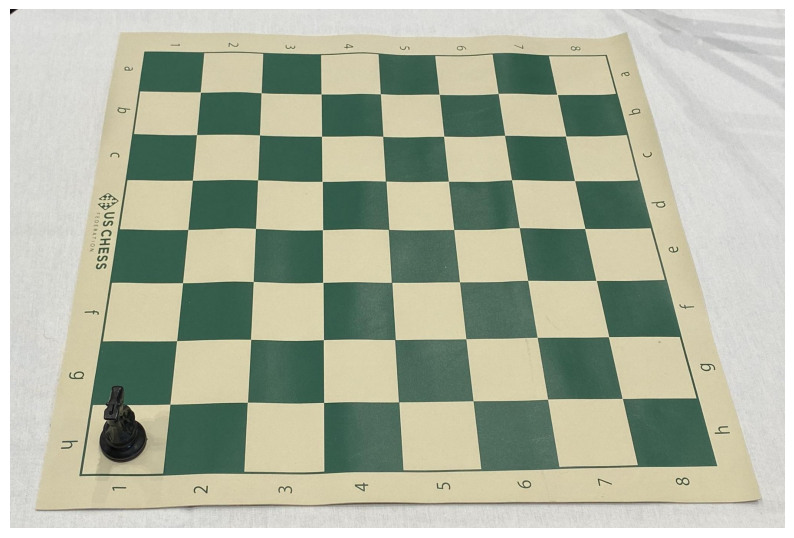

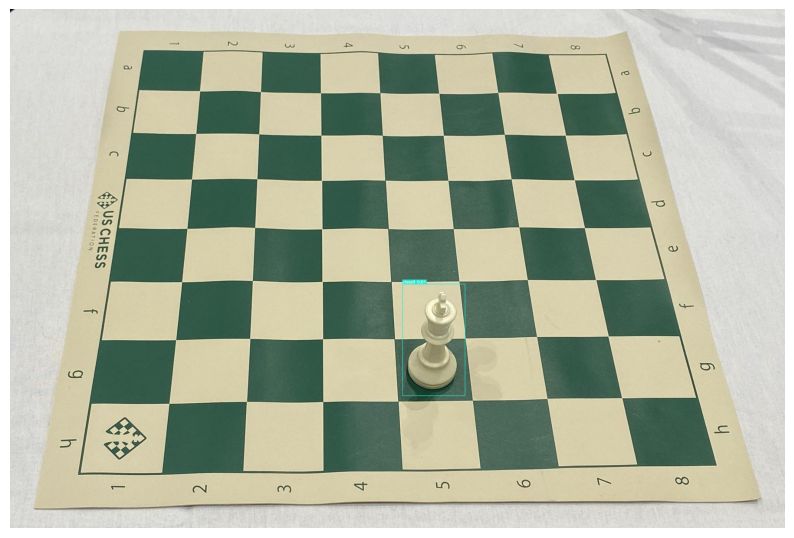

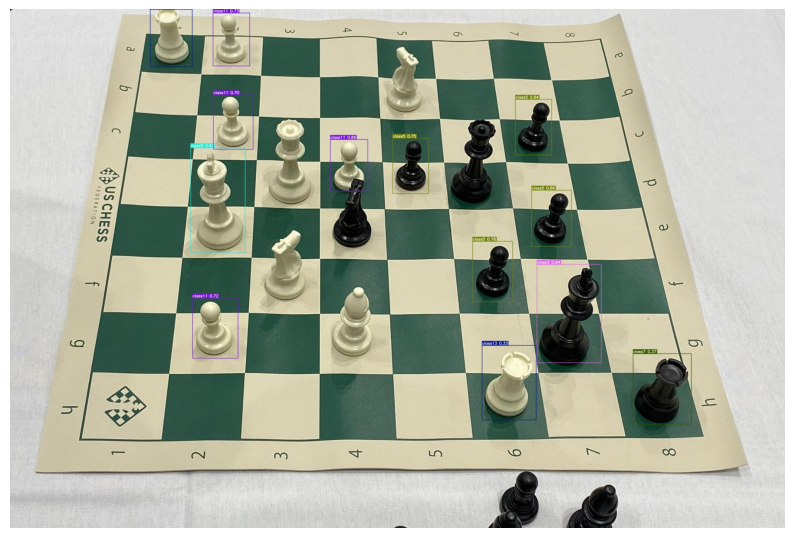

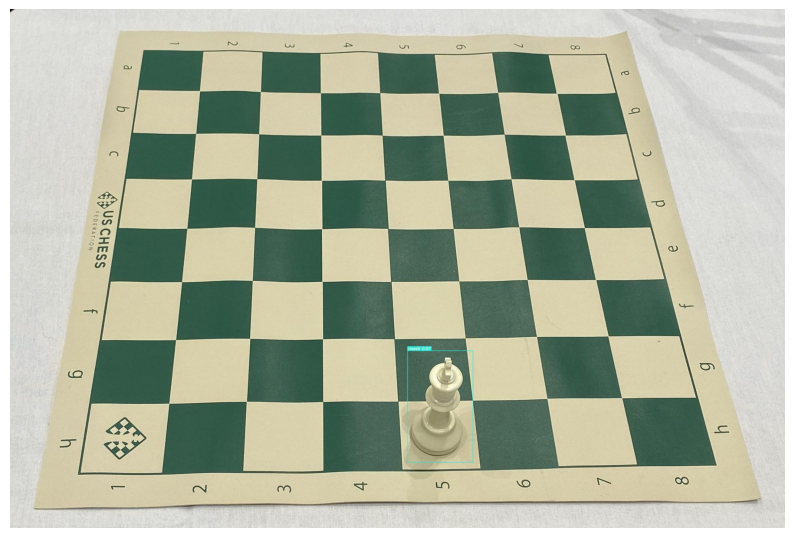

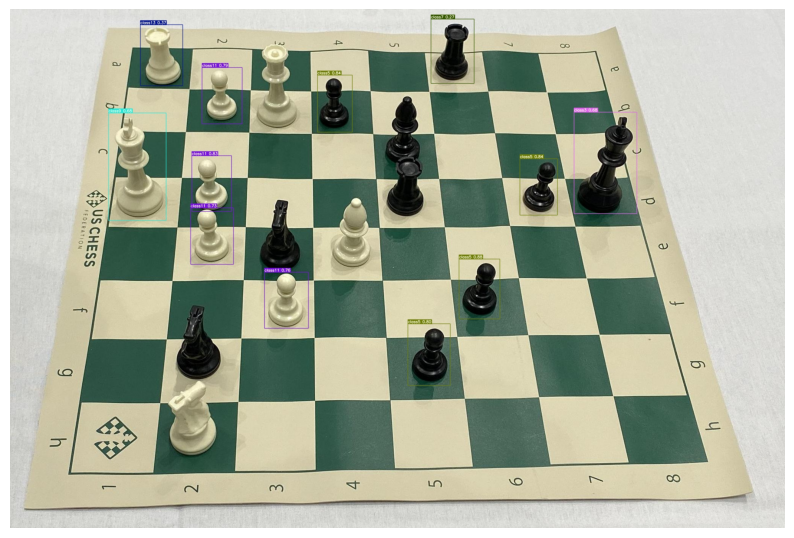

...

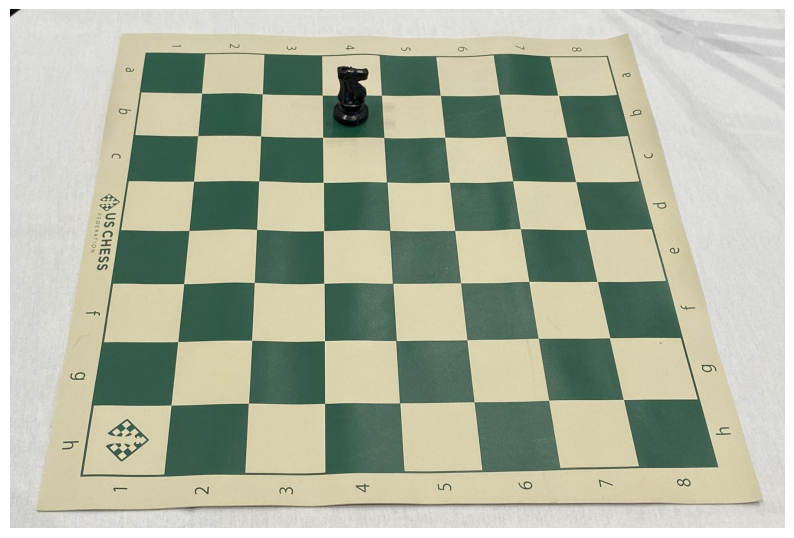

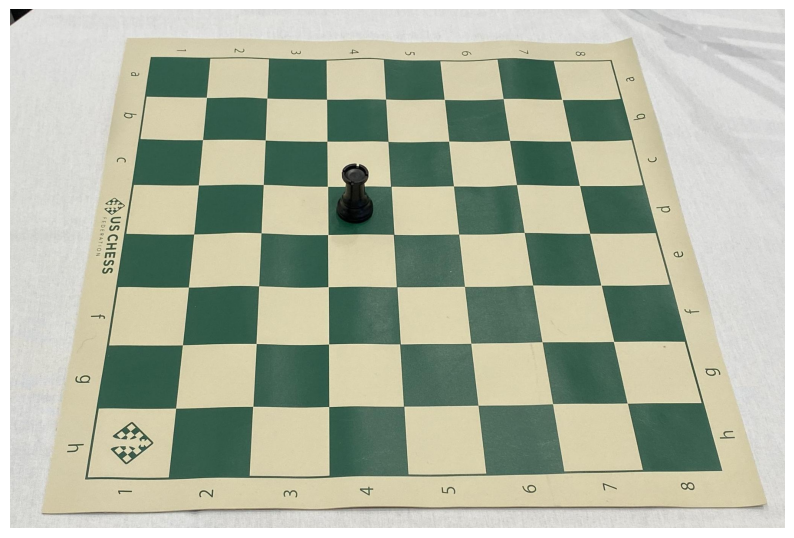

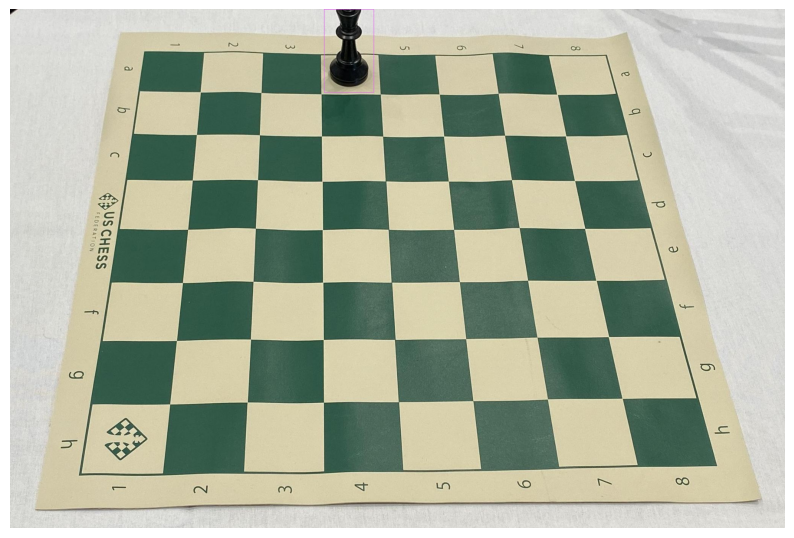

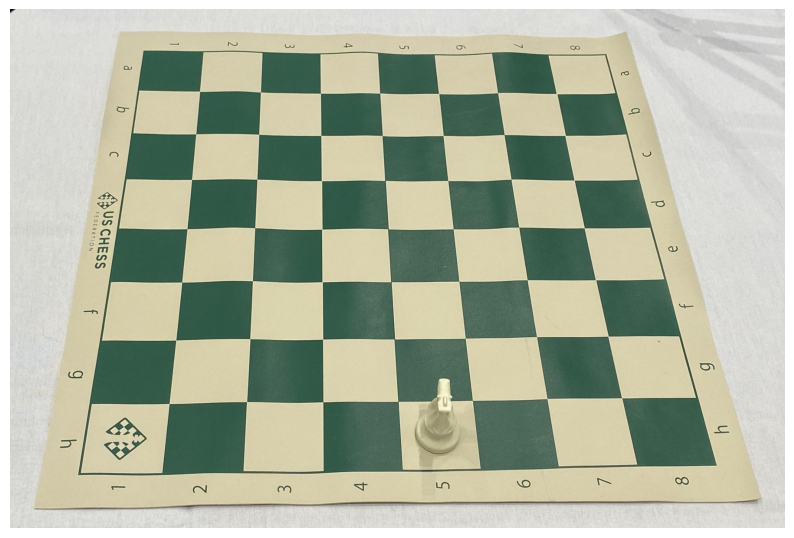

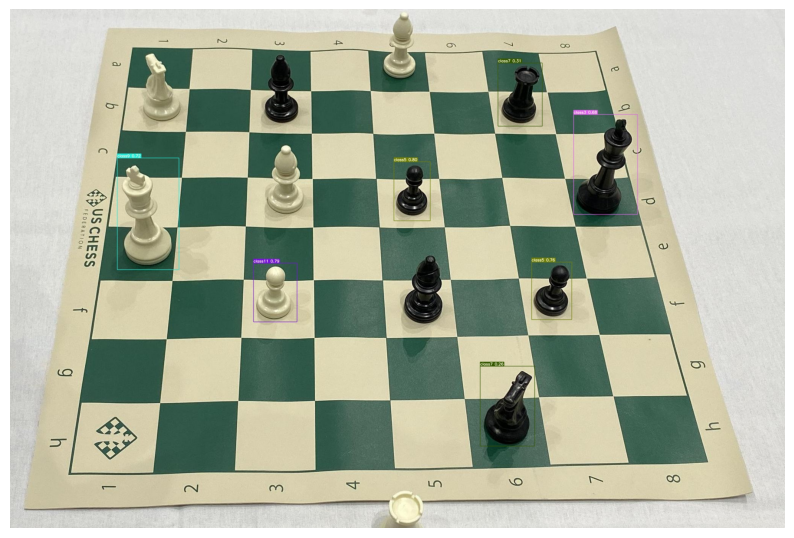

In [ ]:
import cv2
import matplotlib.pyplot as plt
import os

output_dir = '/content/yolov7/runs/detect/exp'

output_files = os.listdir(output_dir)

for file in output_files:
    img_path = os.path.join(output_dir, file)
    img = cv2.imread(img_path)

    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(10, 10))
    plt.imshow(img_rgb)
    plt.axis('off')
    plt.show()